In [118]:
from copy import deepcopy

import numpy as np
import shapefile as shp
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
import json
from matplotlib.animation import FuncAnimation, PillowWriter
from mpl_toolkits.axes_grid1 import make_axes_locatable

from matplotlib.colors import LinearSegmentedColormap

from alarms.utils import generate_cmap, generate_color_palette, MATCH_MAP_NAMES

In [119]:
shapefile_path = "shapefiles/ukr_admbnda_adm1_sspe_20220114.shp"
geo_data = gpd.read_file(shapefile_path)
# Drop Kyiv city shape, to visualize region as a whole
# geo_data.drop(geo_data[geo_data["Shape_Leng"] < 3].index, inplace=True)

<AxesSubplot:>

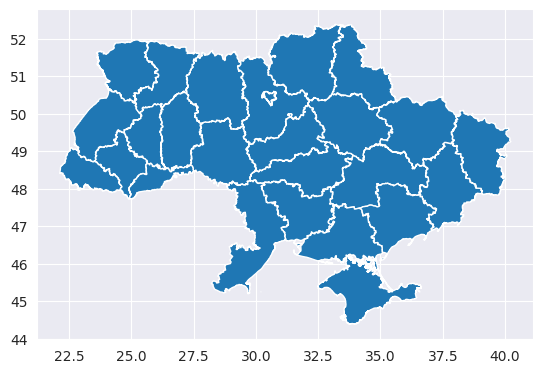

In [120]:
geo_data.plot()

In [121]:
ADM_NAMES = [value for key, value in MATCH_MAP_NAMES.items()]
FIRST_DAY = 74

In [122]:
with open("processed_data/ukraine_alarms.json") as f:
    raw = json.loads(f.read())
alarms_data = pd.DataFrame.from_dict(raw)
alarms_data.drop(columns=['start_datetime', 'start_message', 'end_datetime', 'end_message', 'timedelta'], inplace=True)
alarms_data["adm_region"] = alarms_data["region"].apply(lambda x: MATCH_MAP_NAMES[x])
alarms_data.sort_values(by="day_of_the_year", ascending=True, inplace=True)
alarms_data.head(7)

,region,duration_hours,day_of_the_year,adm_region
0,Vinnytsia region,0.659167,74,Vinnytska
15,Dnipropetrovsk region,0.305278,74,Dnipropetrovska
14,Kirovohrad region,0.414444,74,Kirovohradska
13,Vinnytsia region,0.260833,74,Vinnytska
11,Kyiv region,1.102500,74,Kyivska
10,Vinnytsia region,0.530278,74,Vinnytska
9,Chernihiv region,0.541944,74,Chernihivska


In [123]:
# Find the largest possible value of alerts per region
max_alerts = alarms_data.groupby(alarms_data["adm_region"]).agg({"region": "count"}).region.max()
# Build color palette from min alarms (0) to max
# PALETTE = [x.hex for x in generate_color_palette(max_alerts, "#d25f5f", "#2a0606")]
PALETTE = [x.hex for x in generate_color_palette(max_alerts, "#fdcdcd", "#2a0606")]

In [124]:
yoko_agg_params = {'region': ['count']}
yoko_data = alarms_data[alarms_data["day_of_the_year"] == 74].groupby(alarms_data["adm_region"]).agg(yoko_agg_params)
# # waka_data = alarms_data[alarms_data["day_of_the_year"] == 75].groupby(alarms_data["adm_region"]).agg(days_agg_params)
yoko_data.to_dict()[('region', 'count')]

{'Chernihivska': 1,
 'Dnipropetrovska': 1,
 'Ivano-Frankivska': 1,
 'Kirovohradska': 2,
 'Kyivska': 2,
 'Lvivska': 1,
 'Rivnenska': 1,
 'Ternopilska': 1,
 'Vinnytska': 3,
 'Volynska': 1,
 'Zhytomyrska': 2}

Day 75
Day 76
Day 77
Day 78
Day 79
Day 80
Day 81
Day 82
Day 83
Day 84
Day 85
Day 86
Day 87
Day 88
Day 89
Day 90
Day 91
Day 92
Day 93


/tmp/ipykernel_272330/3701062916.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, figsize=(15, 9))


Day 94
Day 95
Day 96
Day 97
Day 98
Day 99
Day 100
Day 101
Day 102
Day 103
Day 104
Day 105
Day 106
Day 107
Day 108
Day 109
Day 110
Day 111
Day 112
Day 113
Day 114
Day 115
Day 116
Day 117
Day 118
Day 119
Day 120
Day 121
Day 122
Day 123
Day 124
Day 125
Day 126
Day 127
Day 128
Day 129
Day 130
Day 131
Day 132
Day 133
Day 134
Day 135
Day 136
Day 137
Day 138
Day 139
Day 140
Day 141
Day 142
Day 143
Day 144
Day 145
Day 146
Day 147
Day 148
Day 149
Day 150
Day 151
Day 152
Day 153
Day 154
Day 155
Day 156
Day 157
Day 158
Day 159
Day 160
Day 161
Day 162
Day 163
Day 164
Day 165
Day 166
Day 167
Day 168
Day 169
Day 170
Day 171
Day 172
Day 173
Day 174
Day 175
Day 176
Day 177
Day 178
Day 179
Day 180
Day 181
Day 182
Day 183
Day 184
Day 185
Day 186
Day 187
Day 188
Day 189
Day 190
Day 191
Day 192
Day 193
Day 194
Day 195
Day 196
Day 197
Day 198
Day 199
Day 200
Day 201
Day 202
Day 203
Day 204
Day 205
Day 206
Day 207
Day 208
Day 209
Day 210
Day 211
Day 212
Day 213
Day 214
Day 215
Day 216
Day 217
Day 218
Day 21

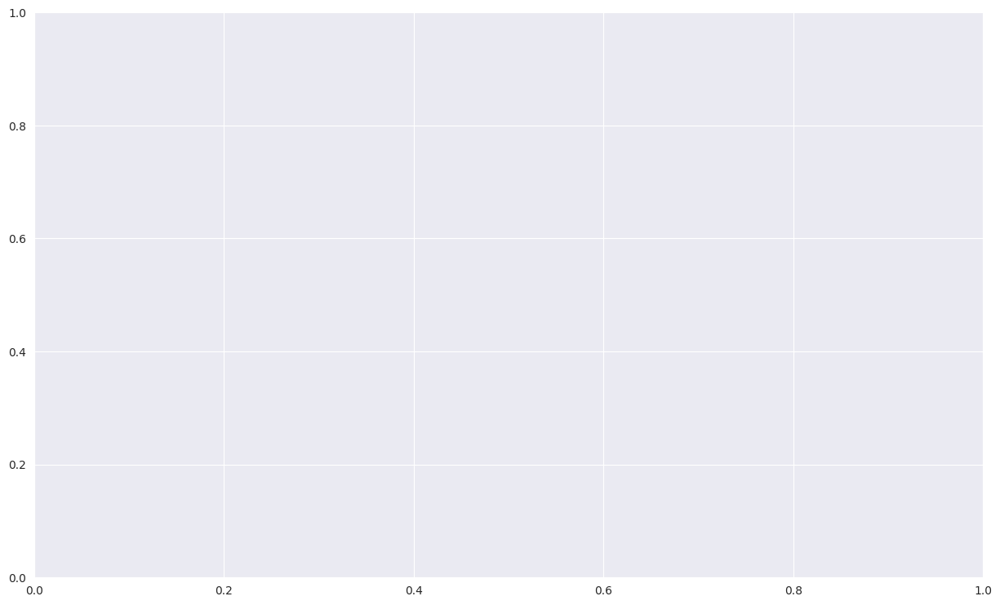

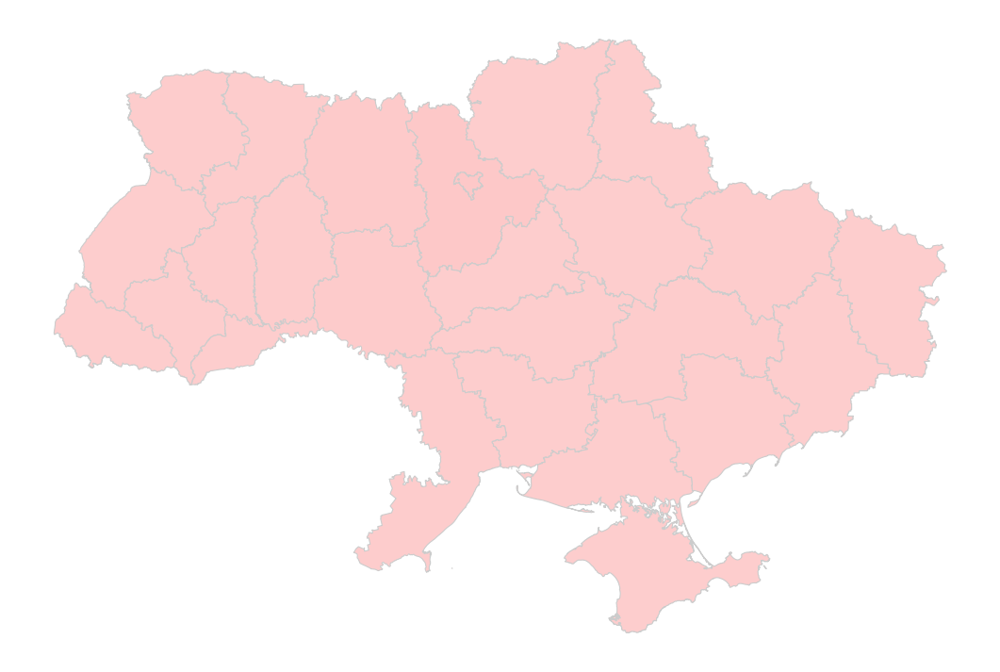

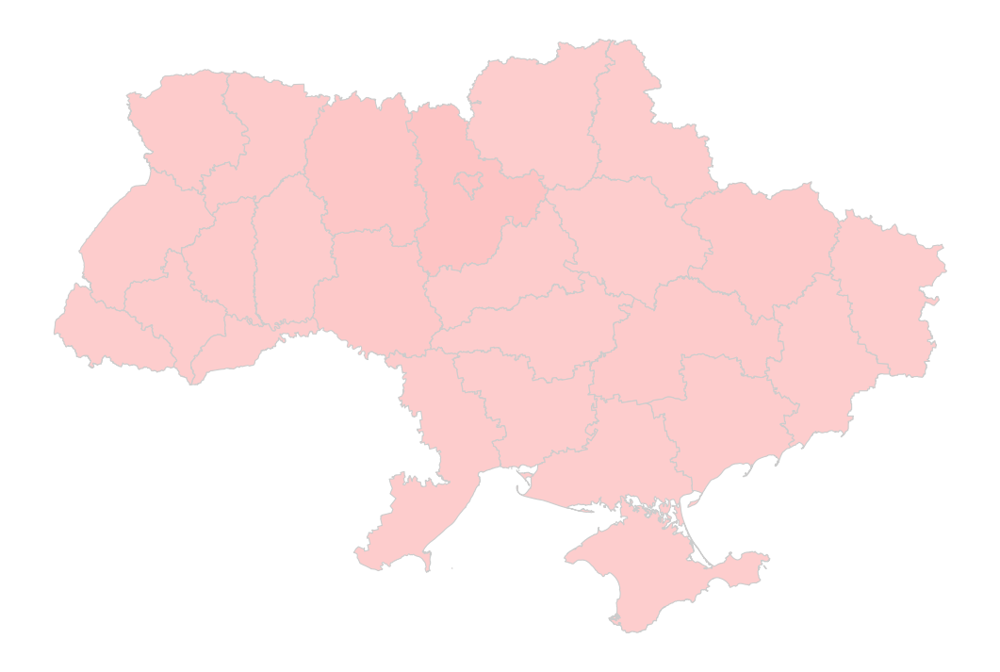

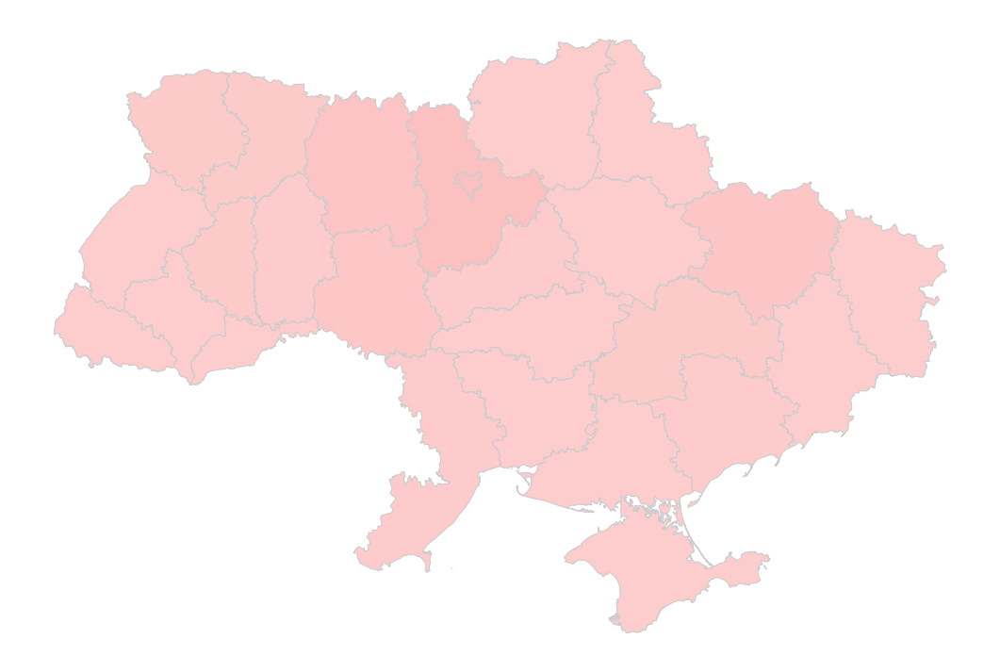

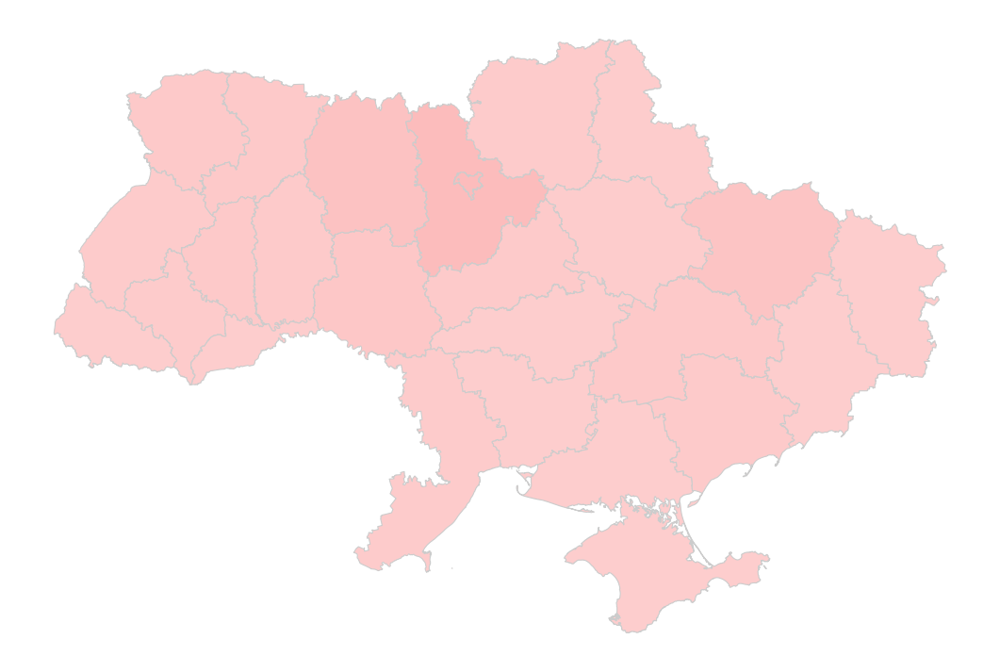

...

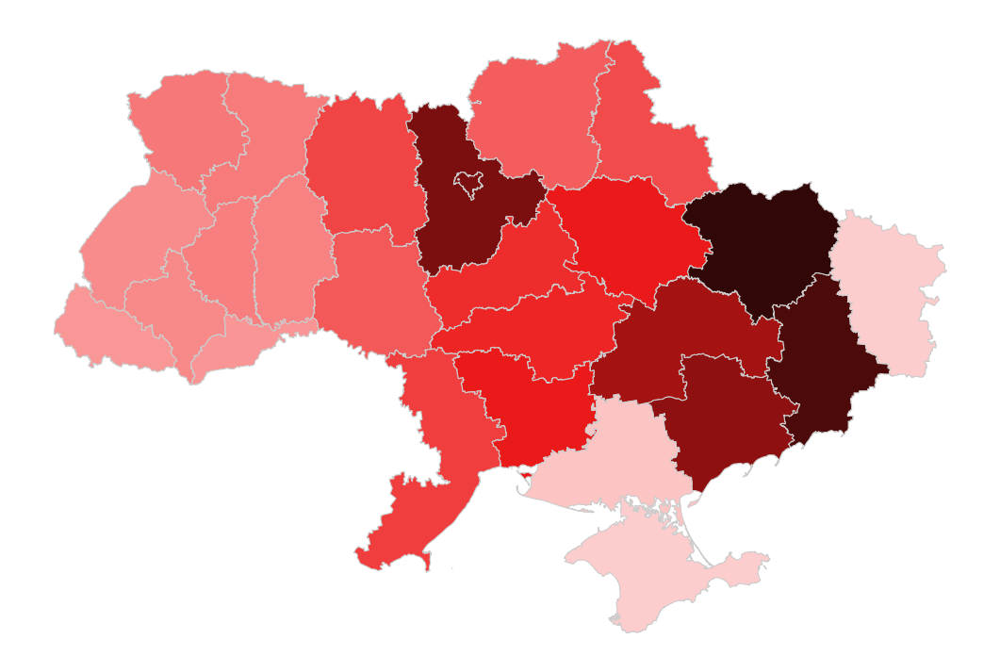

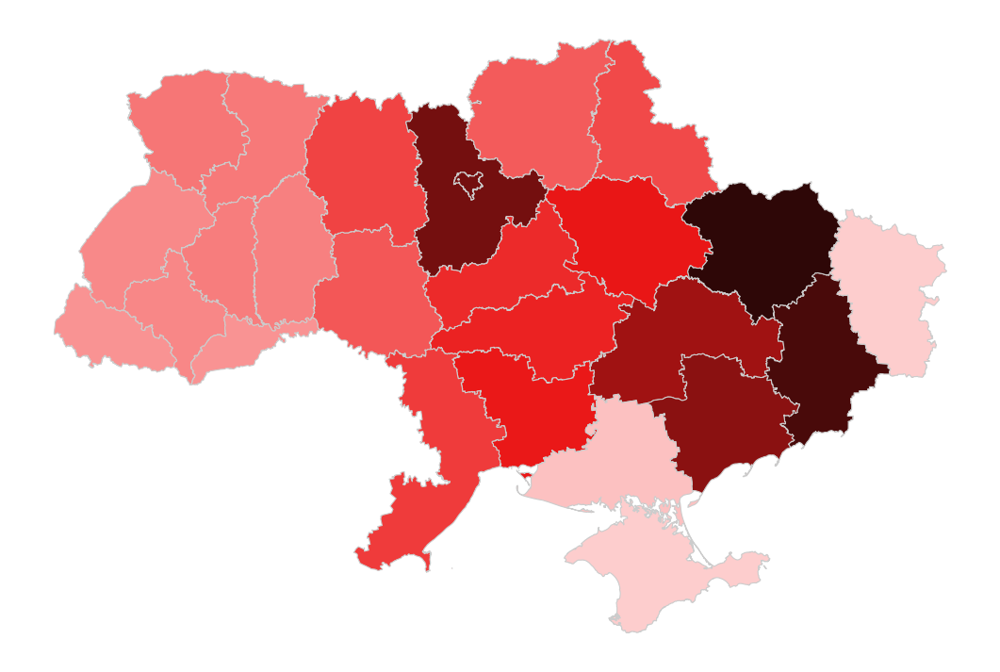

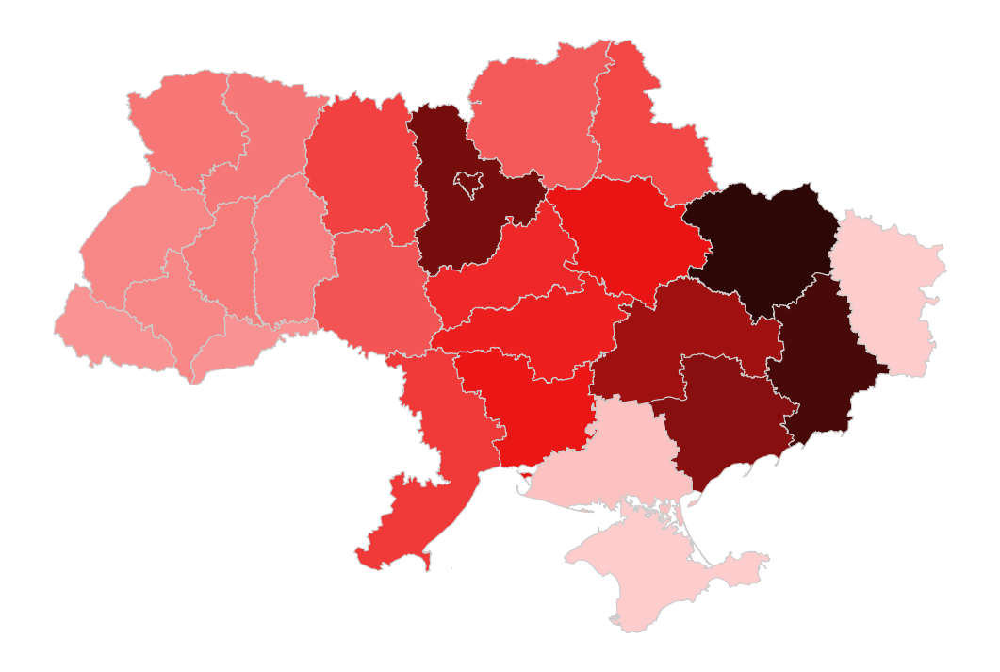

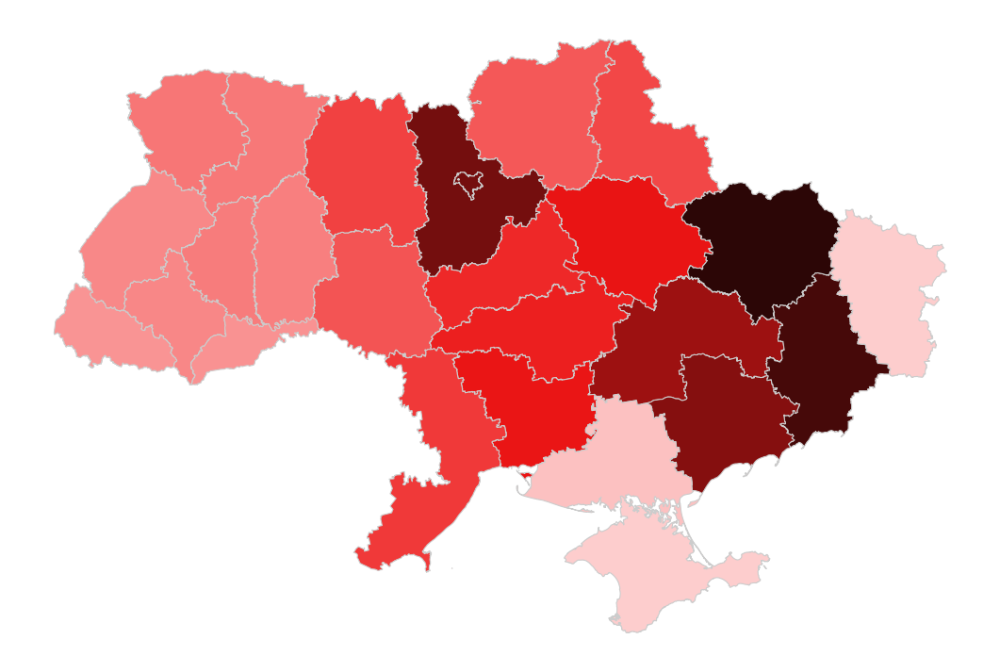

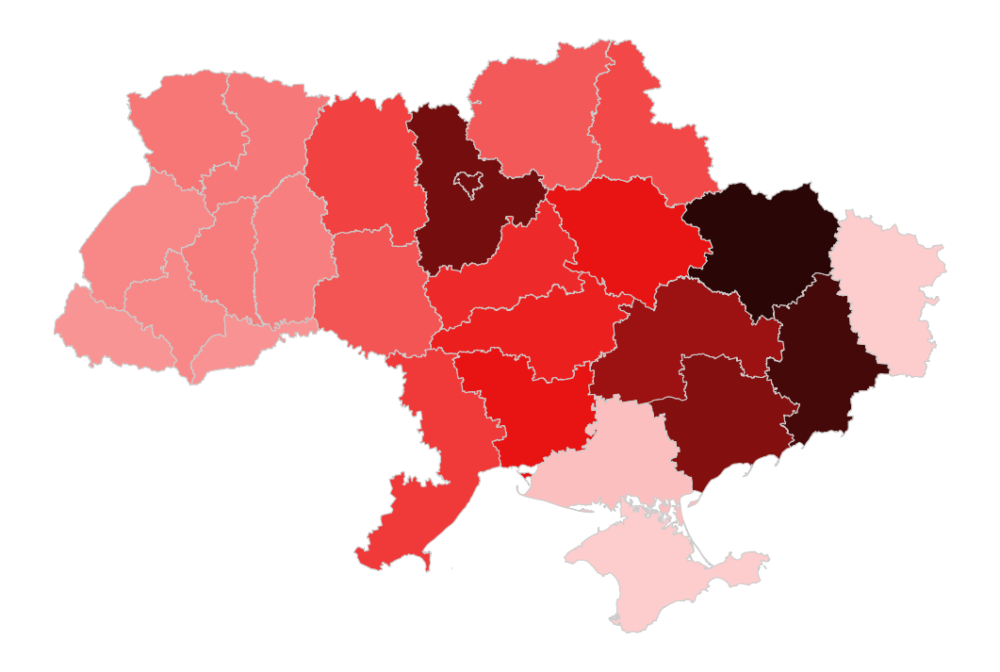

In [125]:
MAP_INCREMENTAL = {}
SKIP_STEP = True
MAP_DATA = None

def animate_days(step_i: int):
    fig, ax = plt.subplots(1, figsize=(15, 9))
    global MAP_INCREMENTAL, SKIP_STEP, MAP_DATA
    # Animation sends step 0 two times (don't know why)
    if step_i == 0 and SKIP_STEP == True:
        SKIP_STEP = False
        return
    print(f"Day {FIRST_DAY + step_i}")
    # Prepare data
    days_agg_params = {'region': ['count']}
    day_data = alarms_data[alarms_data["day_of_the_year"] == (FIRST_DAY + step_i)].groupby(alarms_data["adm_region"]).agg(days_agg_params).to_dict()[('region', 'count')]
    # day_data = day_data.reset_index()
    # Add missing regions (no alerts that day)
    for adm_name in ADM_NAMES:
        if adm_name in day_data:
            continue
        day_data[adm_name] = 0
    # Combine with the previous data
    if len(MAP_INCREMENTAL) == 0:
        MAP_INCREMENTAL = deepcopy(day_data)
    else:
        for key, value in day_data.items():
            MAP_INCREMENTAL[key] += value
    if MAP_DATA is None:
        MAP_DATA = geo_data.copy(deep=True)
        MAP_DATA.set_index("ADM1_EN", inplace=True)
    MAP_DATA["alerts"] = MAP_DATA.index.map(lambda x: MAP_INCREMENTAL[x])
    # Generate cmap based on the min/max values, using previously created palette
    max_days_alerts = MAP_DATA["alerts"].max()
    min_days_hex, max_days_hex = PALETTE[0], PALETTE[max_days_alerts]
    cmap = generate_cmap(len(MAP_DATA), min_days_hex, max_days_hex)
    map_plot = MAP_DATA.plot(
        column="alerts",
        cmap=cmap,
        linewidth=0.8, ax=ax,
        edgecolor="0.8", legend=False,
        legend_kwds={'label': "Alerts"})
    map_plot.set_axis_off()
    plt.savefig(f"images/map/{i}.png")

for i in range(240-FIRST_DAY):
    animate_days(i)

# ani = FuncAnimation(fig, animate_days, 240-FIRST_DAY)
# ani.save(
#     f"images/map.gif", dpi=300, writer=PillowWriter(fps=30)
# )

In [126]:
# from mpl_toolkits.axes_grid1 import make_axes_locatable
#
# # set a variable that will call whatever column we want to visualise on the map
# variable = "alerts"
# # set the range for the choropleth
# # create figure and axes for Matplotlib
# fig, ax = plt.subplots(1, figsize=(10, 6))
#
# divider = make_axes_locatable(ax)
# cax = divider.append_axes("right", size="5%", pad=-1.3)
#
# map_plot = map_data.plot(
#     column=variable,
#     cmap=generate_cmap(len(map_data), "#d25f5f", "#2a0606"),
#     linewidth=0.8, ax=ax,
#     edgecolor="0.8", legend=True,
#     cax=cax, legend_kwds={'label': "Alerts"})
# map_plot.set_axis_off();